# Dirichlet Process Mixture Models in Pyro


## What are Bayesian nonparametric models?
Bayesian nonparametric models are models where the number of parameters grow freely with the amount of data provided; thus, instead of training several models that vary in complexity and comparing them, one is able to design a model whose complexity grows as more data are observed. The prototypical example of Bayesian nonparametrics in practice is the *Dirichlet Process Mixture Model* (DPMM). A DPMM allows for a practitioner to build a mixture model when the number of distinct clusters in the geometric structure of their data is unknown – in other words, the number of clusters is allowed to grow as more data is observed. This feature makes the DPMM highly useful towards exploratory data analysis, where few facets of the data in question are known; this presentation aims to demonstrate this fact.

## The Dirichlet Process (Ferguson, 1973)
Dirichlet processes are a family of probability distributions over discrete probability distributions. Formally, the Dirichlet process (DP) is specified by some base probability distribution $G_0: \Omega \to \mathbb{R}$ and a positive, real, scaling parameter commonly denoted as $\alpha$. A sample $G$ from a Dirichlet process with parameters $G_0: \Omega \to \mathbb{R}$ and $\alpha$ is itself a distribution over $\Omega$. For any disjoint partition $\Omega_1, ..., \Omega_k$ of $\Omega$, and any sample $G \sim DP(G_0, \alpha)$, we have:

$$(G(\Omega_1), ..., G(\Omega_k)) \sim \text{Dir}(\alpha G_0(\Omega_1), ..., \alpha G_0(\Omega_k))$$

Essentially, this is taking a discrete partition of our sample space $\Omega$ and subsequently constructing a discrete distribution over it using the base distribution $G_0$. While quite abstract in formulation, the Dirichlet process is very useful as a prior in various graphical models. This fact becomes easier to see in the following scheme.

## The Chinese Restaurant Process (Aldous, 1985)

Imagine a restaurant with infinite tables (indexed by the positive integers) that accepts customers one at a time. The $n$th customer chooses their seat according to the following probabilities:

*   With probability $\frac{n_t}{\alpha + n - 1}$, sit at table $t$, where $n_t$ is the number of people at table $t$
*   With probability $\frac{\alpha}{\alpha + n - 1}$, sit at an empty table

If we associate to each table $t$ a draw from a base distribution $G_0$ over $\Omega$, and then associate unnormalized probability mass $n_t$ to that draw, the resulting distribution over $\Omega$ is equivalent to a draw from a Dirichlet process $DP(G_0, \alpha)$. 

Furthermore, we can easily extend this to define the generative process of a nonparametric mixture model: every table $t$ that has at least one customer seated is associated with a set of cluster parameters $\theta_t$, which were themselves drawn from some base distribution $G_0$. For each new observation, first assign that observation to a table according to the above probabilities; then, that observation is drawn from the distribution parameterized by the cluster parameters for that table. If the observation was assigned to a new table, draw a new set of cluster parameters from $G_0$, and then draw the observation from the distribution parameterized by those cluster parameters.

While this formulation of a Dirichlet process mixture model is intuitive, it is also very difficult to perform inference on in a probabilistic programming framework. This motivates an alternative formulation of DPMMs, which has empirically been shown to be more conducive to inference (e.g. Blei and Jordan, 2004).

## The Stick-Breaking Method (Sethuraman, 1994)

The generative process for the stick-breaking formulation of DPMMs proceeds as follows:

* Draw $\beta_i \sim \text{Beta}(1, \alpha)$ for $i \in \mathbb{N}$
* Draw $\theta_i \sim G_0$ for $i \in \mathbb{N}$
* Construct the mixture weights $\pi$ by taking $\pi_i(\beta_{1:\infty}) = \beta_i \prod_{j<i} (1-\beta_j)$

* For each observation $n \in \{1, ..., N\}$, draw $z_n \sim \pi(\beta_{1:\infty})$, and then draw $x_n \sim f(\theta_{z_n})$

Here, the infinite nature of the Dirichlet process mixture model can more easily be seen. Furthermore, all $\beta_i$ are independent, so it is far easier to perform inference in a probabilistic programming framework.

First, we import all the modules we're going to need:

In [1]:
!pip install --upgrade pyro-ppl
!pip install --upgrade torch

Requirement already up-to-date: pyro-ppl in /Users/alexkotlar/miniconda3/lib/python3.7/site-packages (1.5.0)
Requirement already up-to-date: torch in /Users/alexkotlar/miniconda3/lib/python3.7/site-packages (1.6.0)


In [27]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from tqdm import tqdm

import torch
from torch import tensor
import torch.nn.functional as F
from torch.distributions import constraints

import pyro
from pyro.distributions import *
from pyro.infer import Predictive, SVI, Trace_ELBO
from pyro.optim import Adam

assert pyro.__version__.startswith('1')
pyro.enable_validation(True)       # can help with debugging
pyro.set_rng_seed(0)



## **Inference**




### Synthetic Mixture of Gaussians

We begin by demonstrating the capabilities of Dirichlet process mixture models on a synthetic dataset generated by a mixture of four 2D Gaussians:

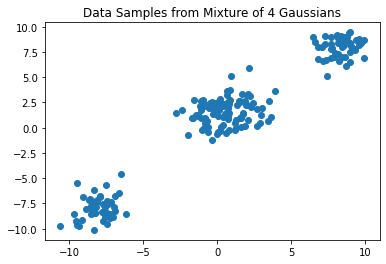

torch.Size([200, 2])

In [4]:

i = 0

data = torch.cat((MultivariateNormal(-8 * torch.ones(2), torch.eye(2)).sample([50]),
                  MultivariateNormal(8 * torch.ones(2), torch.eye(2)).sample([50]),
                  MultivariateNormal(torch.tensor([1.5, 2]), torch.eye(2)).sample([50]),
                  MultivariateNormal(torch.tensor([-0.5, 1]), torch.eye(2)).sample([50])))

plt.scatter(data[:, 0], data[:, 1])
plt.title("Data Samples from Mixture of 4 Gaussians")
plt.show()
N = data.shape[0]
data.shape

In this example, the cluster parameters $\theta_i$ are two dimensional vectors describing the means of a multivariate Gaussian with identity covariance. Therefore, the Dirichlet process base distribution $G_0$ is also a multivariate Gaussian (i.e. the conjugate prior), although this choice is not as computationally useful, since we are not performing coordinate-ascent variational inference but rather black-box variational inference using Pyro. 

First, let's define the "stick-breaking" function that generates our weights, given our samples of $\beta$:

In [5]:
def mix_weights(beta):
    print('beta is', beta)
    beta1m_cumprod = (1 - beta).cumprod(-1)
    print("beta1m_cumprod", beta1m_cumprod)
    print("F.pad(beta, (0, 1), value=1)", F.pad(beta, (0, 1), value=1))
    print("F.pad(beta1m_cumprod, (1, 0), value=1)", F.pad(beta1m_cumprod, (1, 0), value=1))
    t = F.pad(beta, (0, 1), value=1) * F.pad(beta1m_cumprod, (1, 0), value=1)

    return t

Next, let's define our model. It may be helpful to refer the definition of the stick-breaking model presented in the first part of this tutorial. 

Note that all $\beta_i$ samples are conditionally independent, so we model them using a `pyro.plate` of size `T-1`; we do the same for all samples of our cluster parameters $\mu_i$. We then construct a Categorical distribution whose parameters are the mixture weights using our sampled $\beta$ values (line 9) below, and sample the cluster assignment $z_n$ for each data point from that Categorical. Finally, we sample our observations from a multivariate Gaussian distribution whose mean is exactly the cluster parameter corresponding to the assignment $z_n$ we drew for the point $x_n$. This can be seen in the Pyro code below:

In [6]:

def model(data, i):
    # print("in model", i)
    # print("model mode.", T, alpha)
    with pyro.plate("beta_plate", T-1):
        beta = pyro.sample("beta", Beta(1, alpha))

    # q_mu1 = pyro.sample("mu_1", MultivariateNormal(torch.ones(2), torch.eye(2)))
    # q_mu2 = pyro.sample("mu_2", MultivariateNormal(torch.ones(2), torch.eye(2)))
    # q_mu3 = pyro.sample("mu_3", MultivariateNormal(torch.ones(2), torch.eye(2)))
    # q_mu4 = pyro.sample("mu_4", MultivariateNormal(torch.ones(2), torch.eye(2)))
    # q_mu5 = pyro.sample("mu_5", MultivariateNormal(torch.ones(2), torch.eye(2)))
    # q_mu6 = pyro.sample("mu_6", MultivariateNormal(torch.ones(2), torch.eye(2)))
    # # print("q_mu6", q_mu6)
    # mu = torch.stack([q_mu1, q_mu2, q_mu3, q_mu4, q_mu5, q_mu6])
    # print("mu.shape", mu.shape, "mu", mu)
    
    with pyro.plate("mu_plate", T):
    #     # Alex: this could maybe be fixed parameters, shared across all observations with different patterns
    #     # in which case it's not needed
    #     # or could we patterned independently per cluster as raymond had suggested
          mu = pyro.sample("mu_x", MultivariateNormal(torch.zeros(2), 5 * torch.eye(2)))
    #     q_mu1 = pyro.sample("mu_1", MultivariateNormal(torch.eye(2), torch.eye(2)))
    #     q_mu2 = pyro.sample("mu_2", MultivariateNormal(torch.eye(2), torch.eye(2)))
    #     q_mu3 = pyro.sample("mu_3", MultivariateNormal(torch.eye(2), torch.eye(2)))
    #     q_mu4 = pyro.sample("mu_4", MultivariateNormal(torch.eye(2), torch.eye(2)))
    #     q_mu5 = pyro.sample("mu_5", MultivariateNormal(torch.eye(2), torch.eye(2)))
    #     q_mu6 = pyro.sample("mu_6", MultivariateNormal(torch.eye(2), torch.eye(2)))
    #     mu = torch.stack([q_mu1, q_mu2, q_mu3, q_mu4, q_mu5, q_mu6])
    #     print("mu.shape", mu.shape, "mu", mu)
    

    with pyro.plate("data", N):
        # print('beta', beta)
        

        # z is shape N (200 in tutorial)
        # each value is between 0 and 5; 6 
        z = pyro.sample("z", Categorical(mix_weights(beta)))
        # print("z.shape", z.shape, "z", z)
        # mu is shape 6, 2
        # 6 for the number of components, maximum
        # what is the 2 for?
        # print("mu shape", mu.shape)
        # print("mu[z] shape", mu[z].shape)
        pyro.sample("obs", MultivariateNormal(mu[z], torch.eye(2)), obs=data)

        # raise Exception("Blah")

# plt.subplot(1, 2, 2)
# plt.scatter(data[:, 0], data[:, 1], color="blue")

# plt.scatter(Bayes_Centers_15[:, 0], Bayes_Centers_15[:, 1], color="red")
# plt.tight_layout()
# plt.show()

Now, it's time to define our guide and perform inference. 

The variational family $q(\beta, \theta, z)$ that we are optimizing over during variational inference is given by:

$$q(\beta, \theta, z) = \prod_{t=1}^{T-1} q_t(\beta_t) \prod_{t=1}^T q_t(\theta_t) \prod_{n=1}^N q_n(z_n)$$ 

Note that since we are unable to computationally model the infinite clusters posited by the model, we truncate our variational family at $T$ clusters. This does not affect our model; rather, it is a simplification made in the *inference* stage to allow tractability. 

The guide is constructed exactly according to the definition of our variational family $q(\beta, \theta, z)$ above. We have $T-1$ conditionally independent Beta distributions for each $\beta$ sampled in our model, $T$ conditionally independent multivariate Gaussians for each cluster parameter $\mu_i$, and $N$ conditionally independent Categorical distributions for each cluster assignment $z_n$.

Our variational parameters (`pyro.param`) are therefore the $T-1$ many positive scalars that parameterize the second parameter of our variational Beta distributions (the first shape parameter is fixed at $1$, as in the model definition), the $T$ many two-dimensional vectors that parameterize our variational multivariate Gaussian distributions (we do not parameterize the covariance matrices of the Gaussians, though this should be done when analyzing a real-world dataset for more flexibility), and the $N$ many $T$-dimensional vectors that parameterize our variational Categorical distributions:

In [7]:
def tau_chooser(tau):
    # print("tau", tau)
    return tau

def guide(data, i):
    i += 1
    # print("in guide", i)
    kappa = pyro.param('kappa', lambda: Uniform(0, 2).sample([T-1]), constraint=constraints.positive)
    tau = pyro.param('tau', lambda: MultivariateNormal(torch.zeros(2), 3 * torch.eye(2)).sample([T]))
    # print("tau.shape", tau.shape)
    # print("T is", T, "tau", tau)
    phi = pyro.param('phi', lambda: Dirichlet(1/T * torch.ones(T)).sample([N]), constraint=constraints.simplex)

    # q_mu1 = pyro.sample("mu_1", MultivariateNormal(torch.ones(2), torch.eye(2)))
    # q_mu2 = pyro.sample("mu_2", MultivariateNormal(torch.ones(2), torch.eye(2)))
    # q_mu3 = pyro.sample("mu_3", MultivariateNormal(torch.ones(2), torch.eye(2)))
    # q_mu4 = pyro.sample("mu_4", MultivariateNormal(torch.ones(2), torch.eye(2)))
    # q_mu5 = pyro.sample("mu_5", MultivariateNormal(torch.ones(2), torch.eye(2)))
    # q_mu6 = pyro.sample("mu_6", MultivariateNormal(torch.ones(2), torch.eye(2)))
    # print("q_mu6", q_mu6)
    with pyro.plate("beta_plate", T-1):
        # print("in guide, beta plate", T-1, kappa)
        q_beta = pyro.sample("beta", Beta(torch.ones(T-1), kappa))

    with pyro.plate("mu_plate", T):
    #     print("in guide, mu plate", T, tau)
    #     tau2 = tau_chooser(tau)
    #     print("tau2", tau2)
        c = pyro.sample("mu_x", MultivariateNormal(tau, torch.eye(2)))
        # print("c", c)
    #     q_mu2 = pyro.sample("mu_2", MultivariateNormal(torch.eye(2), torch.eye(2)))
    #     q_mu3 = pyro.sample("mu_3", MultivariateNormal(torch.eye(2), torch.eye(2)))
    #     q_mu4 = pyro.sample("mu_4", MultivariateNormal(torch.eye(2), torch.eye(2)))
    #     q_mu5 = pyro.sample("mu_5", MultivariateNormal(torch.eye(2), torch.eye(2)))
    #     q_mu6 = pyro.sample("mu_6", MultivariateNormal(torch.eye(2), torch.eye(2)))

    with pyro.plate("data", N):
        # print("in data plate", N, phi)
        z = pyro.sample("z", Categorical(phi))

    # raise Exception("RAN guide")

When performing inference, we set our 'guess' for the maximum number of clusters in the dataset to $T = 6$. We define the optimization algorithm (`pyro.optim.Adam`) along with the Pyro SVI object and train the model for 1000 iterations. 

After performing inference, we construct the Bayes estimators of the means (the expected values of each factor in our variational approximation) and plot them in red on top of the original dataset.  Note that we also have we removed any clusters that have less than a certain weight assigned to them according to our learned variational distributions, and then re-normalize the weights so that they sum to one:

In [10]:
T = 6
optim = Adam({"lr": 0.05})
svi = SVI(model, guide, optim, loss=Trace_ELBO())
losses = []

def train(num_iterations):
    pyro.clear_param_store()
    for j in tqdm(range(num_iterations)):
        loss = svi.step(data, j)
        losses.append(loss)

def truncate(alpha, centers, weights):
    threshold = alpha**-1 / 100.
    true_centers = centers[weights > threshold]
    true_weights = weights[weights > threshold] / torch.sum(weights[weights > threshold])
    return true_centers, true_weights

alpha = tensor(1.5) #* #sparse prior
train(1000)

# We make a point-estimate of our model parameters using the posterior means of tau and phi for the centers and weights
Bayes_Centers_01, Bayes_Weights_01 = truncate(alpha, pyro.param("tau").detach(), torch.mean(pyro.param("phi").detach(), dim=0))

alpha = tensor(1.5)
train(1000)

# We make a point-estimate of our model parameters using the posterior means of tau and phi for the centers and weights
# Bayes_Centers_15, Bayes_Weights_15 = truncate(alpha, pyro.param("tau").detach(), torch.mean(pyro.param("phi").detach(), dim=0))

# plt.figure(figsize=(15, 5))
# plt.subplot(1, 2, 1)
# plt.scatter(data[:, 0], data[:, 1], color="blue")
# plt.scatter(Bayes_Centers_01[:, 0], Bayes_Centers_01[:, 1], color="red")

# plt.subplot(1, 2, 2)
# plt.scatter(data[:, 0], data[:, 1], color="blue")

# plt.scatter(Bayes_Centers_15[:, 0], Bayes_Centers_15[:, 1], color="red")
# plt.tight_layout()
# plt.show()


F.pad(beta1m_cumprod, (1, 0), value=1) tensor([1.0000, 0.7194, 0.6066, 0.5740, 0.4305, 0.3102],
       grad_fn=<ConstantPadNdBackward>)
beta is tensor([0.1506, 0.0953, 0.0616, 0.1656, 0.5528], grad_fn=<SelectBackward>)
beta1m_cumprod tensor([0.8494, 0.7685, 0.7211, 0.6017, 0.2691], grad_fn=<CumprodBackward>)
F.pad(beta, (0, 1), value=1) tensor([0.1506, 0.0953, 0.0616, 0.1656, 0.5528, 1.0000],
       grad_fn=<ConstantPadNdBackward>)
F.pad(beta1m_cumprod, (1, 0), value=1) tensor([1.0000, 0.8494, 0.7685, 0.7211, 0.6017, 0.2691],
       grad_fn=<ConstantPadNdBackward>)
beta is tensor([0.5093, 0.4940, 0.3779, 0.1623, 0.5929], grad_fn=<SelectBackward>)
beta1m_cumprod tensor([0.4907, 0.2483, 0.1545, 0.1294, 0.0527], grad_fn=<CumprodBackward>)
F.pad(beta, (0, 1), value=1) tensor([0.5093, 0.4940, 0.3779, 0.1623, 0.5929, 1.0000],
       grad_fn=<ConstantPadNdBackward>)
F.pad(beta1m_cumprod, (1, 0), value=1) tensor([1.0000, 0.4907, 0.2483, 0.1545, 0.1294, 0.0527],
       grad_fn=<ConstantPadNdBa

KeyboardInterrupt: 

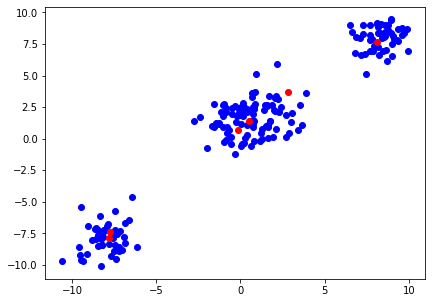

In [220]:
plt.figure(figsize=(15, 5))
plt.subplot(1, 2, 1)
plt.scatter(data[:, 0], data[:, 1], color="blue")
plt.scatter(Bayes_Centers_01[:, 0], Bayes_Centers_01[:, 1], color="red")

# plt.subplot(1, 2, 2)
# plt.scatter(data[:, 0], data[:, 1], color="blue")

# plt.scatter(Bayes_Centers_15[:, 0], Bayes_Centers_15[:, 1], color="red")
# plt.tight_layout()
plt.show()

In [196]:
Bayes_Centers_01

tensor([[-2.0029, -2.0700]])

In [15]:
mix_weights(torch.tensor([1,2,4]))

tensor([1, 0, 0, 0])

The plots above demonstrate the effects of the scaling hyperparameter $\alpha$. A greater $\alpha$ yields a more heavy-tailed distribution of the weights, whereas smaller $\alpha$ will place more mass on fewer clusters. In particular, the middle cluster looks like it could be generated a single Gaussian (although in fact it was generated by two distinct Gaussians), and thus the setting of $\alpha$ allows the practitioner to further encode their prior beliefs about how many clusters the data contains.

### Dirichlet Mixture Model for Long Term Solar Observations 

As mentioned earlier, the Dirichlet process mixture model truly shines when exploring a dataset whose latent geometric structure is completely unknown. To demonstrate this, we fit a DPMM on sunspot count data taken over the past 300 years (provided by the Royal Observatory of Belgium):

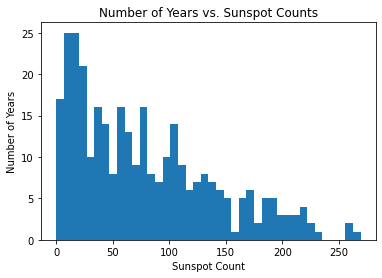

In [7]:
df = pd.read_csv('http://www.sidc.be/silso/DATA/SN_y_tot_V2.0.csv', sep=';', names=['time', 'sunspot.year'], usecols=[0, 1])
data = torch.tensor(df['sunspot.year'].values, dtype=torch.float32).round()
N = data.shape[0]

plt.hist(df['sunspot.year'].values, bins=40)
plt.title("Number of Years vs. Sunspot Counts")
plt.xlabel("Sunspot Count")
plt.ylabel("Number of Years")
plt.show()

For this example, the cluster parameters $\theta_i$ are rate parameters since we are constructing a scale-mixture of Poisson distributions. Again, $G_0$ is chosen to be the conjugate prior, which in this case is a Gamma distribution, though this still does not strictly matter for doing inference through Pyro. Below is the implementation of the model:

100%|██████████| 1500/1500 [00:08<00:00, 178.17it/s]


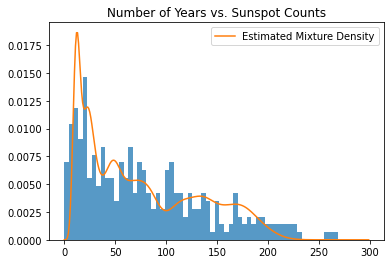

In [8]:
def model(data):
    with pyro.plate("beta_plate", T-1):
        beta = pyro.sample("beta", Beta(1, alpha))

    with pyro.plate("lambda_plate", T):
        lmbda = pyro.sample("lambda", Gamma(3, 0.05))
    
    with pyro.plate("data", N):
        z = pyro.sample("z", Categorical(mix_weights(beta)))
        pyro.sample("obs", Poisson(lmbda[z]), obs=data)

def guide(data):
    kappa = pyro.param('kappa', lambda: Uniform(0, 2).sample([T-1]), constraint=constraints.positive)
    tau_0 = pyro.param('tau_0', lambda: Uniform(0, 5).sample([T]), constraint=constraints.positive)
    tau_1 = pyro.param('tau_1', lambda: LogNormal(-1, 1).sample([T]), constraint=constraints.positive)
    phi = pyro.param('phi', lambda: Dirichlet(1/T * torch.ones(T)).sample([N]), constraint=constraints.simplex)

    with pyro.plate("beta_plate", T-1):
        q_beta = pyro.sample("beta", Beta(torch.ones(T-1), kappa))

    with pyro.plate("lambda_plate", T):
        q_lambda = pyro.sample("lambda", Gamma(tau_0, tau_1))

    with pyro.plate("data", N):
        z = pyro.sample("z", Categorical(phi))

T = 20
alpha = 1.1
n_iter = 1500
optim = Adam({"lr": 0.05})
svi = SVI(model, guide, optim, loss=Trace_ELBO())
losses = []

train(n_iter)

samples = torch.arange(0, 300).type(torch.float)

tau0_optimal = pyro.param("tau_0").detach()
tau1_optimal = pyro.param("tau_1").detach()
kappa_optimal = pyro.param("kappa").detach()

# We make a point-estimate of our latent variables using the posterior means of tau and kappa for the cluster params and weights
Bayes_Rates = (tau0_optimal / tau1_optimal)
Bayes_Weights = mix_weights(1. / (1. + kappa_optimal))

def mixture_of_poisson(weights, rates, samples):
    return (weights * Poisson(rates).log_prob(samples.unsqueeze(-1)).exp()).sum(-1)

likelihood = mixture_of_poisson(Bayes_Weights, Bayes_Rates, samples)

plt.title("Number of Years vs. Sunspot Counts")
plt.hist(data, bins=60, density=True, lw=0, alpha=0.75);
plt.plot(samples, likelihood, label="Estimated Mixture Density")
plt.legend()
plt.show()

The above plot is the mixture density of the Bayes estimators of the cluster parameters, weighted by their corresponding weights. As in the Gaussian example, we have taken the Bayes estimators of each cluster parameter and their corresponding weights by computing the posterior means of `lambda` and `beta` respectively.

### ELBO Behavior

Below are plots of the behavior of the loss function (negative Trace_ELBO) over the SVI iterations during inference using Pyro, as well as a plot of the autocorrelations of the ELBO 'time series' versus iteration number. We can see that around 500 iterations, the loss stops decreasing significantly, so we can assume it takes around 500 iterations to achieve convergence. The autocorrelation plot reaches an autocorrelation very close to 0 around a lag of 500, further corroborating this hypothesis. Note that these are heuristics and do not necessarily imply convergence.

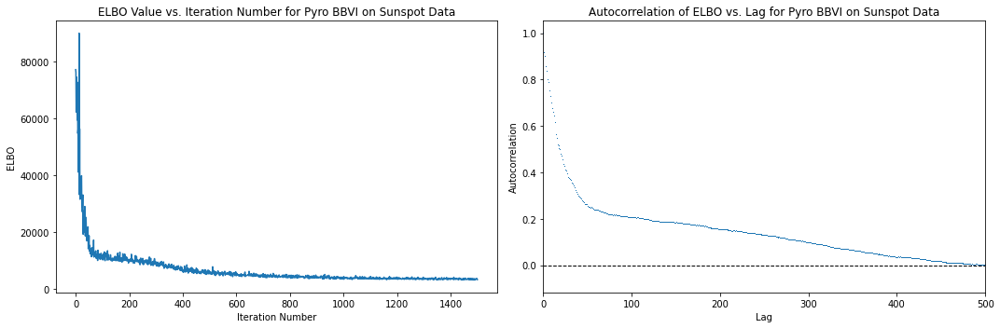

In [9]:
elbo_plot = plt.figure(figsize=(15, 5))

elbo_ax = elbo_plot.add_subplot(1, 2, 1)
elbo_ax.set_title("ELBO Value vs. Iteration Number for Pyro BBVI on Sunspot Data")
elbo_ax.set_ylabel("ELBO")
elbo_ax.set_xlabel("Iteration Number")
elbo_ax.plot(np.arange(n_iter), losses)

autocorr_ax = elbo_plot.add_subplot(1, 2, 2)
autocorr_ax.acorr(np.asarray(losses), detrend=lambda x: x - x.mean(), maxlags=750, usevlines=False, marker=',')
autocorr_ax.set_xlim(0, 500)
autocorr_ax.axhline(0, ls="--", c="k", lw=1)
autocorr_ax.set_title("Autocorrelation of ELBO vs. Lag for Pyro BBVI on Sunspot Data")
autocorr_ax.set_xlabel("Lag")
autocorr_ax.set_ylabel("Autocorrelation")
elbo_plot.tight_layout()
plt.show()


## **Criticism**




### Long-Term Sunspot Model

Since we computed the approximate posterior of the DPMM that was fit to the long-term sunspot data, we can utilize some intrinsic metrics, such as the log predictive, posterior dispersion indices, and posterior predictive checks. 

Since the posterior predictive distribution for a Dirichlet process mixture model is itself a scale-mixture distribution that has an analytic approximation [(Blei and Jordan, 2004)](http://www.cs.columbia.edu/~blei/papers/BleiJordan2004.pdf), this makes it particularly amenable to the aforementioned metrics:

$$p(x_{new} | X_{1:N}, \alpha, G_0) \approx \sum_{t=1}^T \mathbb{E}_q [\pi_t(\beta)] \ \mathbb{E}_q \left[p(x_{new} | \theta_t)\right].$$

In particular, to compute the log predictive, we first compute the posterior predictive distribution (defined above) after performing variational inference on our model using a training subsample of our data. The log predictive is then the log value of the predictive density evaluated at each point in the test subsample:

$$\log p(x_{new} | X) = \log \mathbb{E}_{\beta, \theta | X} \left[ p(x_{new} | \beta, \theta) \right]$$

Since both the training samples and the testing samples were taken from the same dataset, we would expect the model to assign high probability to the test samples, despite not having seen them during inference. This gives a metric by which to select values of $T$, $\alpha$, and $G_0$, our hyperparameters: we would want to choose the values that maximize this value.

We perform this process below with varying values of $\alpha$ to see what the optimal setting is.

In [16]:
# Hold out 10% of our original data to test upon
df_test = df.sample(frac=0.1)
data = torch.tensor(df.drop(df_test.index)['sunspot.year'].values, dtype=torch.float).round()
data_test = torch.tensor(df_test['sunspot.year'].values, dtype=torch.float).round()
N = data.shape[0]
N_test = data_test.shape[0]

alphas = [0.05, 0.1, 0.5, 0.75, 0.9, 1., 1.25, 1.5, 2, 2.5, 3]
log_predictives = []

for val in alphas:
    alpha = val
    T = 20
    svi = SVI(model, guide, optim, loss=Trace_ELBO())
    train(500)
    
    S = 100 # number of Monte Carlo samples to use in posterior predictive computations

    # Using pyro's built in posterior predictive class:
    posterior = Predictive(guide, num_samples=S, return_sites=["beta", "lambda"])(data)
    post_pred_weights = mix_weights(posterior["beta"])
    post_pred_clusters = posterior["lambda"]

    # log_prob shape = N_test x S
    log_prob = (post_pred_weights.log() + Poisson(post_pred_clusters).log_prob(data.reshape(-1, 1, 1))).logsumexp(-1)
    mean_log_prob = log_prob.logsumexp(-1) - np.log(S)
    log_posterior_predictive = mean_log_prob.sum(-1)
    log_predictives.append(log_posterior_predictive)

plt.figure(figsize=(10, 5))
plt.plot(alphas, log_predictives)
plt.title("Value of the Log Predictive at Varying Alpha")
plt.show()

  0%|          | 0/500 [00:00<?, ?it/s]


ValueError: The parameter concentration has invalid values
    Trace Shapes:       
     Param Sites:       
            kappa     19
            tau_0     20
            tau_1     20
              phi 288 20
    Sample Sites:       
  beta_plate dist      |
            value  19  |
        beta dist  19  |
            value  19  |
lambda_plate dist      |
            value  20  |

From the above plot, we would surmise that we want to set $\alpha > 1$, though the signal is not quite clear. A more comprehensive model criticism process would involve performing a grid search across all hyperparameters in order to find the one that maximizes the log predictive.


## References



1.   Ferguson, Thomas. *A Bayesian Analysis of Some Nonparametric Problems*. The Annals of Statistics, Vol. 1, No. 2 (1973). 
2.   Aldous, D. *Exchangeability and Related Topics*. Ecole diete de Probabilities Saint Flour (1985).
3.   Sethuraman, J. *A Constructive Definition of Dirichlet Priors*. Statistica, Sinica, 4:639-650 (1994).
4.   Blei, David and Jordan, Michael. *Variational Inference for Dirichlet Process Mixtures*. Bayesian Analysis, Vol. 1, No. 1 (2004).
5.   Pedregosa, et al. *Scikit-Learn: Machine Learning in Python*. JMLR 12, pp. 2825-2830 (2011).
6.   Bishop, Christopher. *Pattern Recogition and Machine Learning*. Springer Ltd (2006).
7.   *Sunspot Index and Long-Term Solar Observations*. WDC-SILSO, Royal Observatory of Belgium, Brussels (2018).
9.   Gelman, Andrew. *Understanding predictive information criteria for Bayesian models*. Statistics and Computing, Springer Link, 2014.





In [1]:
%load_ext autoreload
%autoreload 2
%reload_ext autoreload

In [3]:
from mvl import genData, likelihoods, bayes, popgen
from mvl.likelihoods import getAlphas, getPis
from torch import tensor

# liabParams = {"pDs": tensor([.01, .01, .002])}
liabParams23 = genData.genParams(pis=tensor([.1, .1, .02]), rrMeans=tensor([20, 2]), afMean = tensor(1e-4), pDs = tensor([.01, .1]), afShape=tensor(500.), nCases=tensor([1.5e4, 1.5e4, 4e3]), nCtrls=tensor(5e4), covShared=tensor([ [1., 0], [0, 1] ]), covSingle=tensor([ [1., 0], [0, 1] ]), meanEffectCovarianceScale=tensor(.001))
print("liabParams23", liabParams23)
liabData23 = genData.v6liability(**liabParams23[0])
liabParams23[0]["pDs"] = liabData23["PDs"] #TODO: normalized names, and indicate that the params pDs are incomplete

liabParams23 [{'nGenes': 20000, 'nCases': tensor([15000., 15000.,  4000.]), 'nCtrls': tensor(50000.), 'pDs': tensor([0.0100, 0.1000]), 'diseaseFractions': tensor([0.1000, 0.1000, 0.0200]), 'rrShape': tensor(10.), 'rrMeans': tensor([20,  2]), 'afShape': tensor(500.), 'afMean': tensor(1.0000e-04), 'covShared': tensor([[1., 0.],
        [0., 1.]]), 'covSingle': tensor([[1., 0.],
        [0., 1.]]), 'meanEffectCovarianceScale': tensor(0.0010), 'rrtype': 'default'}]
covShared tensor([[1., 0.],
        [0., 1.]])
residualCovariance tensor([[1., 0.],
        [0., 1.]])
PD1 threshold, PD2 threshold tensor(-2.3263) tensor(-1.2816)
pDsWithBoth tensor([0.0100, 0.1000, 0.0010], dtype=torch.float64)
pdThresh tensor([2.3263, 1.2816])
pdTarget tensor([0.2000, 0.2000])
pdvthresh tensor([0.8416, 0.8416])
meanEffect tensor([1.4847, 0.4399])
meanEffectsAcrossAllGenes tensor([1.4847, 0.4399])
allEffects tensor([[-1.4491, -0.4035],
        [-1.4768, -0.4262],
        [-1.5116, -0.4618],
        ...,
      

In [20]:
from numpyro.contrib.tfp.distributions import Multinomial, DirichletMultinomial
import jax
rng = jax.random.PRNGKey(10)

t = DirichletMultinomial(concentration=[1., 2], total_count=10)

In [31]:
t.sample([100000], seed=rng).mean()

DeviceArray(5., dtype=float32)

In [26]:
!pip install -U "tfp-nightly[jax]"
# !pip install -

Requirement already up-to-date: tfp-nightly[jax] in /Users/alexkotlar/miniconda3/lib/python3.7/site-packages (0.12.0.dev20201010)


In [18]:
from pyro.distributions import DirichletMultinomial as PDM
from torch import tensor
t2 = PDM(concentration=tensor([1., 2]), total_count=10)

In [30]:
t2.sample([100000]).mean()

tensor(5.)

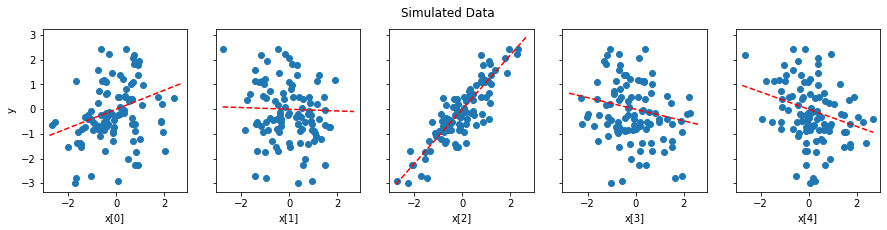

In [33]:
import numpy as np
import matplotlib.pyplot as plt

# Trailing underscore means the model has no access to the variable
np.random.seed(0)

ndims = 5
ndata = 100
X = np.random.randn(ndata, ndims)
w_ = np.random.randn(ndims)

noise_ = 0.1 * np.random.randn(ndata)
y_obs = X.dot(w_) + noise_


fig, axes = plt.subplots(sharey=True, ncols=ndims, figsize=(15, 3))

t = np.linspace(X.min(), X.max())
for idx, (ax, x) in enumerate(zip(axes.ravel(), X.T)):
    ax.plot(x, y_obs, 'o');
    ax.plot(t, w_[idx] * t, 'r--')
    ax.set_xlabel(f'x[{idx}]')
axes[0].set_ylabel('y')
fig.suptitle('Simulated Data');

In [44]:
import tensorflow as tf
import tensorflow_probability as tfp
tfd = tfp.distributions

X_tensor = tf.convert_to_tensor(X, dtype='float32')

@tf.function
def target_log_prob_fn(w):
    w_dist = tfd.Normal(loc=tf.zeros((ndims, 1)), scale=1.0, name="w")
    w_prob = tf.reduce_sum(w_dist.log_prob(w))
    y_dist = tfd.Normal(loc=tf.matmul(X_tensor, w), scale=0.1, name="y")
    y_prob = tf.reduce_sum(y_dist.log_prob(y_obs.reshape(-1, 1)))
    return w_prob + y_prob


# Initialize the HMC transition kernel.
num_results = 1000
num_burnin_steps = 500
adaptive_hmc = tfp.mcmc.SimpleStepSizeAdaptation(
    tfp.mcmc.HamiltonianMonteCarlo(
        target_log_prob_fn=target_log_prob_fn,
        num_leapfrog_steps=4,
        step_size=0.01),
    num_adaptation_steps=int(num_burnin_steps * 0.8))

samples, is_accepted = tfp.mcmc.sample_chain(
    num_results=num_results,
    num_burnin_steps=num_burnin_steps,
    current_state=tf.zeros((ndims, 1)),
    kernel=adaptive_hmc,
    trace_fn=lambda _, pkr: pkr.inner_results.is_accepted)

In [35]:
samples

<tf.Tensor: shape=(1000, 5, 1), dtype=float32, numpy=
array([[[ 0.3592143 ],
        [-0.04005221],
        [ 1.091309  ],
        [-0.23784813],
        [-0.3531801 ]],

       [[ 0.36087847],
        [-0.02866996],
        [ 1.094623  ],
        [-0.24037798],
        [-0.3589326 ]],

       [[ 0.36860672],
        [-0.0365334 ],
        [ 1.1007797 ],
        [-0.24310146],
        [-0.35150826]],

       ...,

       [[ 0.37295598],
        [-0.0406755 ],
        [ 1.1006752 ],
        [-0.22739308],
        [-0.3441758 ]],

       [[ 0.37341288],
        [-0.03895677],
        [ 1.1022236 ],
        [-0.22656229],
        [-0.34562677]],

       [[ 0.37202394],
        [-0.03893113],
        [ 1.1035967 ],
        [-0.2243856 ],
        [-0.34548125]]], dtype=float32)>

In [36]:
import pyro
import torch
from pyro.infer.mcmc import NUTS, MCMC
import pyro.distributions as dist


def model(X):
    w = pyro.sample('w', dist.Normal(torch.zeros(ndims), torch.ones(ndims)))
    y = pyro.sample('y', dist.Normal(torch.matmul(X, w), 0.1 * torch.ones(ndata)), obs=torch.as_tensor(y_obs, dtype=torch.float32))
    return y

nuts_kernel = NUTS(model, adapt_step_size=True)
py_mcmc = MCMC(nuts_kernel, num_samples=1_000, warmup_steps=500)

py_mcmc = py_mcmc.run(torch.as_tensor(X, dtype=torch.float32))

Sample: 100%|██████████| 1500/1500 [00:09, 155.79it/s, step size=6.47e-01, acc. prob=0.918]



In [43]:
import jax.numpy as jnp
from jax import random
from jax.config import config; config.update("jax_platform_name", "cpu")

import numpyro.distributions as dist
from numpyro import sample
from numpyro.infer.util import initialize_model
from numpyro.infer import mcmc



def model(X):
    w = sample('w', dist.Normal(jnp.zeros(ndims), jnp.ones(ndims)))
    y = sample('y', dist.Normal(jnp.matmul(X, w), 0.1 * jnp.ones(ndata)), obs=y_obs)

rng = random.PRNGKey(0)

init_params, potential_fn, constrain_fn = initialize_model(rng, model, X=X)
num_warmup, num_samples = 1000, 1000

# Run NUTS.
npyro_samples = mcmc(num_warmup, num_samples, init_params,
                 potential_fn=potential_fn, 
                 trajectory_length=10, 
                 constrain_fn=constrain_fn)

TypeError: initialize_model() got an unexpected keyword argument 'X'

In [8]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from tqdm import tqdm

import torch
import torch.nn.functional as F
from torch.distributions import constraints

import pyro
from pyro.distributions import *
from pyro.infer import Predictive, SVI, Trace_ELBO
from pyro.optim import Adam

assert pyro.__version__.startswith('1')
pyro.enable_validation(True)       # can help with debugging
pyro.set_rng_seed(0)

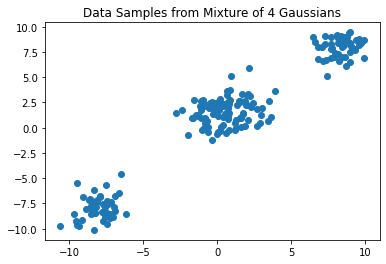

In [47]:

data = torch.cat((MultivariateNormal(-8 * torch.ones(2), torch.eye(2)).sample([50]),
                  MultivariateNormal(8 * torch.ones(2), torch.eye(2)).sample([50]),
                  MultivariateNormal(torch.tensor([1.5, 2]), torch.eye(2)).sample([50]),
                  MultivariateNormal(torch.tensor([-0.5, 1]), torch.eye(2)).sample([50])))

plt.scatter(data[:, 0], data[:, 1])
plt.title("Data Samples from Mixture of 4 Gaussians")
plt.show()
N = data.shape[0]

In [46]:
def mix_weights(beta):
    beta1m_cumprod = (1 - beta).cumprod(-1)
    return F.pad(beta, (0, 1), value=1) * F.pad(beta1m_cumprod, (1, 0), value=1)
    
def model(data):
    with pyro.plate("beta_plate", T-1):
        beta = pyro.sample("beta", Beta(1, alpha))

    with pyro.plate("mu_plate", T):
        mu = pyro.sample("mu", MultivariateNormal(torch.zeros(2), 5 * torch.eye(2)))

    with pyro.plate("data", N):
        z = pyro.sample("z", Categorical(mix_weights(beta)))
        pyro.sample("obs", MultivariateNormal(mu[z], torch.eye(2)), obs=data)

In [48]:
def guide(data):
    kappa = pyro.param('kappa', lambda: Uniform(0, 2).sample([T-1]), constraint=constraints.positive)
    tau = pyro.param('tau', lambda: MultivariateNormal(torch.zeros(2), 3 * torch.eye(2)).sample([T]))
    phi = pyro.param('phi', lambda: Dirichlet(1/T * torch.ones(T)).sample([N]), constraint=constraints.simplex)

    with pyro.plate("beta_plate", T-1):
        q_beta = pyro.sample("beta", Beta(torch.ones(T-1), kappa))

    with pyro.plate("mu_plate", T):
        q_mu = pyro.sample("mu", MultivariateNormal(tau, torch.eye(2)))

    with pyro.plate("data", N):
        z = pyro.sample("z", Categorical(phi))

100%|██████████| 1000/1000 [00:14<00:00, 67.12it/s]


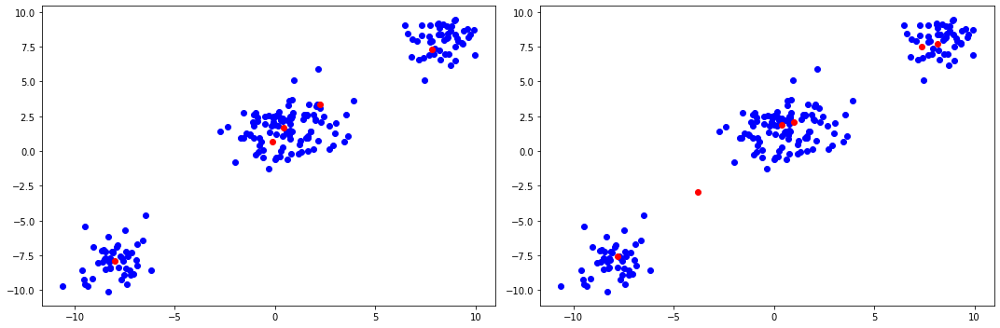

In [49]:
T = 6
optim = Adam({"lr": 0.05})
svi = SVI(model, guide, optim, loss=Trace_ELBO())
losses = []

def train(num_iterations):
    pyro.clear_param_store()
    for j in tqdm(range(num_iterations)):
        loss = svi.step(data)
        losses.append(loss)

def truncate(alpha, centers, weights):
    threshold = alpha**-1 / 100.
    true_centers = centers[weights > threshold]
    true_weights = weights[weights > threshold] / torch.sum(weights[weights > threshold])
    return true_centers, true_weights

alpha = 0.1
train(1000)

# We make a point-estimate of our model parameters using the posterior means of tau and phi for the centers and weights
Bayes_Centers_01, Bayes_Weights_01 = truncate(alpha, pyro.param("tau").detach(), torch.mean(pyro.param("phi").detach(), dim=0))

alpha = 1.5
train(1000)

# We make a point-estimate of our model parameters using the posterior means of tau and phi for the centers and weights
Bayes_Centers_15, Bayes_Weights_15 = truncate(alpha, pyro.param("tau").detach(), torch.mean(pyro.param("phi").detach(), dim=0))

plt.figure(figsize=(15, 5))
plt.subplot(1, 2, 1)
plt.scatter(data[:, 0], data[:, 1], color="blue")
plt.scatter(Bayes_Centers_01[:, 0], Bayes_Centers_01[:, 1], color="red")

plt.subplot(1, 2, 2)
plt.scatter(data[:, 0], data[:, 1], color="blue")
plt.scatter(Bayes_Centers_15[:, 0], Bayes_Centers_15[:, 1], color="red")
plt.tight_layout()
plt.show()

In [ ]:
def model(data):
    with pyro.plate("beta_plate", T-1):
        beta = pyro.sample("beta", Beta(1, alpha))

    with pyro.plate("mu_plate", T):
        mu = pyro.sample("alphas", LogNormal(torch.zeros(5), torch.ones(5)).sample())

    with pyro.plate("data", N):
        z = pyro.sample("z", Categorical(mix_weights(beta)))
        pyro.sample("obs", MultivariateNormal(mu[z], torch.eye(2)), obs=data)

def guide(data):
    kappa = pyro.param('kappa', lambda: Uniform(0, 2).sample([T-1]), constraint=constraints.positive)
    tau = pyro.param('tau', lambda: MultivariateNormal(torch.zeros(2), 3 * torch.eye(2)).sample([T]))
    phi = pyro.param('phi', lambda: Dirichlet(1/T * torch.ones(T)).sample([N]), constraint=constraints.simplex)

    with pyro.plate("beta_plate", T-1):
        q_beta = pyro.sample("beta", Beta(torch.ones(T-1), kappa))

    with pyro.plate("mu_plate", T):
        q_mu = pyro.sample("mu", MultivariateNormal(tau, torch.eye(2)))

    with pyro.plate("data", N):
        z = pyro.sample("z", Categorical(phi))

In [10]:
Gamma(torch.ones(5), torch.ones(5)).sample()

tensor([0.5231, 0.6051, 0.0685, 0.9643, 2.2103])

In [13]:
Gamma(torch.ones(sampleCat), torch.ones(sampleCat)).sample()

tensor([0.8810, 1.1524, 0.9182, 1.5752])

In [22]:
from mvl import genData
from torch import tensor

liabParams55cov = genData.genParams(pis=tensor([.1, .1, .05]), rrMeans=tensor([3., 2.]), afMean = tensor(5e-4), pDs = tensor([.01, .01]), afShape=tensor(50.), nCases=tensor([1.5e4, 1.5e4, 4e3]), nCtrls=tensor(5e4), covShared=tensor([ [1, .95], [.95, 1] ]), meanEffectCovarianceScale=tensor(.01))[0]
liabParams55cov["pDs"] = liabParams55cov["pDs"][0:2]
liabData55cov = genData.v6liability(**liabParams55cov)
liabParams55cov["pDsSample"] = liabData55cov["PDs"] #TODO: normalized names, and indicate that the params pDs are incomplete

covShared tensor([[1.0000, 0.9500],
        [0.9500, 1.0000]])
residualCovariance tensor([[1, 0],
        [0, 1]])
PD1 threshold, PD2 threshold tensor(-2.3263) tensor(-2.3263)
pDsWithBoth tensor([0.0100, 0.0100, 0.0067], dtype=torch.float64)
pdThresh tensor([2.3263, 2.3263])
pdTarget tensor([0.0300, 0.0200])
pdvthresh tensor([1.8808, 2.0537])
meanEffect tensor([0.4456, 0.2726])
meanEffectsAcrossAllGenes tensor([0.4456, 0.2726])
allEffects tensor([[-0.5328, -0.3888],
        [-0.4841, -0.3334],
        [-0.4452, -0.2369],
        ...,
        [-0.4445, -0.3102],
        [-0.4414, -0.3237],
        [-0.4142, -0.3063]])
PD1GivenV.mean() tensor(0.0306) PD2GivenV.mean() tensor(0.0205)
allEffects[i] tensor([-0.5328, -0.3888])
PDBothGivenV.mean tensor(0.0171, dtype=torch.float64)
PDBothGivenV / PDBoth tensor(2.5561, dtype=torch.float64)
pdsCovarOnMean.mean(0) tensor([0.0306, 0.0205, 0.0171], dtype=torch.float64)
np.corrcoef(pdvInBoth[:,0], pdvInBoth[:,1])
 [[1.         0.95060835]
 [0.9506083

In [23]:
liabData55cov["afs"]

tensor([[3.3940e-04, 1.0182e-04, 1.0182e-04, 2.7152e-05],
        [3.4679e-04, 1.0404e-04, 1.0404e-04, 2.7743e-05],
        [2.4426e-04, 7.3277e-05, 7.3277e-05, 1.9540e-05],
        ...,
        [2.8361e-04, 8.5084e-05, 8.5084e-05, 2.2689e-05],
        [2.2761e-04, 6.8283e-05, 6.8283e-05, 1.8209e-05],
        [2.7143e-04, 1.9707e-04, 8.3381e-05, 5.2551e-05]], dtype=torch.float64)

In [62]:
import pyro
import torch
from torch.nn import functional as F
from pyro.distributions import *
from pyro.distributions import Multinomial as MN
import pyro.distributions as pdist
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from tqdm import tqdm

import torch
from torch import tensor
import torch.nn.functional as F
from torch.distributions import constraints

import pyro
from pyro.distributions import *
from pyro.infer import Predictive, SVI, Trace_ELBO
from pyro.optim import Adam

assert pyro.__version__.startswith('1')
pyro.enable_validation(True)       # can help with debugging
pyro.set_rng_seed(0)

nHypotheses = 4
kConditions = 4
N = len(liabData55cov["altCounts"])

nCases = liabParams55cov["nCases"]
nCtrls = liabParams55cov["nCtrls"]
samplePDs = nCases / (nCases.sum() + nCtrls)
pdsAll = tensor([1 - samplePDs.sum(), *samplePDs])
print("pdsAll", pdsAll)
# pdsAllPop = tensor([1 - pDs.sum(), *pDs])
# print("pdsall", pdsAllPop)
# pdsAll = pdsAllPop
pdsAllShaped = pdsAll.expand(nHypotheses, kConditions)

def mix_weights(beta):
    beta1m_cumprod = (1 - beta).cumprod(-1)
    return F.pad(beta, (0, 1), value=1) * F.pad(beta1m_cumprod, (1, 0), value=1)
    

# tfpdsAllShaped = tf.convert_to_tensor(pdsAllShaped)
# total_count = liabData55cov["altCounts"].sum(1)
# print(total_count.shape, total_count)
alpha = .05
def model(data):
    with pyro.plate("beta_plate", nHypotheses-1):
        beta = pyro.sample("beta", Beta(1, alpha))

    with pyro.plate("mu_plate", nHypotheses):
        # Alex: this could maybe be fixed parameters, shared across all observations with different patterns
        # in which case it's not needed
        # or could we patterned independently per cluster as raymond had suggested
        # probs = pyro.sample("probs", Dirichlet(torch.ones(kConditions)))
        # print("probs")
        conc = pyro.sample('conc', Exponential( tensor(.001).expand(T)).to_event(1) )
        # print("conc in model", conc)
        probs = pyro.sample("probs", Dirichlet(conc * pdsAll))
        # print( "probs in model", probs)

    with pyro.plate("data", N):
        # print('beta', beta)
        z = pyro.sample("z", Categorical(mix_weights(beta)))
        # print("probs", probs[z].shape, probs[z])
        return pyro.sample("obs", MN(probs=probs[z], validate_args=False), obs=data)
    
def guide(data):
    alphas = pyro.param("alphas", lambda: Gamma(torch.ones(kConditions), torch.ones(kConditions)).sample())
    kappa = pyro.param('kappa', lambda: Uniform(0, 2).sample([T-1]), constraint=constraints.positive)
    # tau = pyro.param('tau', lambda: MultivariateNormal(torch.zeros(2), 3 * torch.eye(2)).sample([T]))
    phi = pyro.param('phi', lambda: Dirichlet(1/nHypotheses * torch.ones(nHypotheses)).sample([N]), constraint=constraints.simplex)
    # print("alphas", alphas)
    with pyro.plate("beta_plate", nHypotheses-1):
        q_beta = pyro.sample("beta", Beta(torch.ones(T-1), kappa))

    with pyro.plate("mu_plate", nHypotheses):
        # alphas = alphas.detach().numpy()
        # print("alphas", alphas[0])
        # aShaped = tensor([
        #     [alphas[0], alphas[0], alphas[0], alphas[0]],
        #     [alphas[0], alphas[1], alphas[0], alphas[1]],
        #     [alphas[0], alphas[0], alphas[2], alphas[2]],
        #     alphas
        # ])
        conc = pyro.sample('conc', Exponential( tensor(.001).expand(T)).to_event(1) )
        # print("Conc in guide", conc)
        # print("aShaped", aShaped)
        probs = pyro.sample("probs", Dirichlet(conc * pdsAll))
        # print("probs in guide", probs)
        # print("probs.shape", probs.shape)

    with pyro.plate("data", N):
        z = pyro.sample("z", Categorical(phi))

pdsAll tensor([0.5952, 0.1786, 0.1786, 0.0476])


In [21]:
kernel = pyro.infer.mcmc.NUTS(model, jit_compile=True)
torch.multiprocessing.set_sharing_strategy("file_system")
import time
start = time.time()
NUM_WARMUP = 1000
NUM_SAMPLES = 1000
NUM_CHAINS = 6
posterior = pyro.infer.mcmc.MCMC(kernel,
                      num_samples=NUM_SAMPLES,
                      warmup_steps=NUM_WARMUP,
                      num_chains=NUM_CHAINS,
                      disable_progbar=False).run(liabData55cov["altCounts"].float())

pyro_time = time.time() - start

ze=3.32e-03, acc. prob=0.762]
Warmup [2]:   2%|▏         | 31/2000 [00:27,  1.53s/it, step size=5.03e-03, acc. prob=0.776]

Warmup [2]:   2%|▏         | 33/2000 [00:28,  1.00s/it, step size=7.09e-04, acc. prob=0.755]

Warmup [3]:   1%|          | 24/2000 [00:29,  2.36s/it, step size=1.77e-03, acc. prob=0.745]


Warmup [4]:   1%|          | 23/2000 [00:31,  2.42s/it, step size=5.59e-03, acc. prob=0.771]


Warmup [4]:   1%|          | 24/2000 [00:31,  1.79s/it, step size=5.67e-04, acc. prob=0.739]

Warmup [3]:   1%|▏         | 25/2000 [00:34,  3.17s/it, step size=3.23e-03, acc. prob=0.755]

Warmup [3]:   1%|▏         | 26/2000 [00:35,  2.55s/it, step size=5.34e-03, acc. prob=0.764]


Warmup [4]:   1%|▏         | 25/2000 [00:36,  2.69s/it, step size=1.04e-03, acc. prob=0.749]

Warmup [3]:   1%|▏         | 27/2000 [00:36,  1.92s/it, step size=5.85e-04, acc. prob=0.735]




Warmup [6]:   1%|          | 20/2000 [00:36,  6.41s/it, step size=2.57e-03, acc. prob=0.754]




Warmup [6]:   1%|    

KeyboardInterrupt: 

In [55]:
def summary(posterior, sites, diagnostics=True):
    marginal = posterior.marginal(sites)
    site_stats = {}
    for site in sites:
        marginal_site = marginal.support(flatten=True)[site]
        site_stats[site] = get_site_stats(marginal_site.numpy(), site)
        if diagnostics and posterior.num_chains > 1:
            diag = marginal.diagnostics()[site]
            site_stats[site] = site_stats[site].assign(
                n_eff=diag["n_eff"].numpy(), r_hat=diag["r_hat"].numpy())
    return site_stats


sites = ["alpha", "beta", "sigma"]
df = pd.concat([s for s in summary(posterior, sites).values()])
print(df)

NameError: name 'posterior' is not defined

In [69]:
T = 6
optim = Adam({"lr": 0.05})
svi = SVI(model, guide, optim, loss=Trace_ELBO())
losses = []
alpha = tensor(.05)
def train(num_iterations):
    pyro.clear_param_store()
    for j in tqdm(range(num_iterations)):
        loss = svi.step(liabData55cov["altCounts"].float())
        losses.append(loss)

def truncate(alpha, weights):
    threshold = alpha**-1 / 100.
    # true_centers = centers[weights > threshold]
    true_weights = weights[weights > threshold] / torch.sum(weights[weights > threshold])
    return true_weights

# alpha = 0.1
train(1000)

# We make a point-estimate of our model parameters using the posterior means of tau and phi for the centers and weights
# Bayes_Centers_01, Bayes_Weights_01 = truncate(alpha, pyro.param("tau").detach(), torch.mean(pyro.param("phi").detach(), dim=0))


  0%|          | 0/1000 [00:00<?, ?it/s]


ValueError: Shape mismatch inside plate('beta_plate') at site beta dim -1, 3 vs 5
  Trace Shapes:        
   Param Sites:        
         alphas       4
          kappa       5
            phi 20000 4
  Sample Sites:        
beta_plate dist       |
          value     3 |

In [68]:
Dirichlet(torch.mean(pyro.param("phi").detach(), dim=0)).mean

tensor([0.2297, 0.2510, 0.3061, 0.2132])

In [46]:
Exponential(tensor(.001).expand(4)).sample()

tensor([ 681.9933,  108.1037, 2172.8757, 1496.3551])

In [32]:
torch.mean(pyro.param("beta").detach(), dim=0)

KeyError: 'beta'

In [328]:
pyro.param("phi").detach() * pyro.param("phi").detach()

tensor([[2.6498e-01, 3.0066e-02, 3.8819e-03, 6.2267e-02],
        [6.1383e-05, 3.7630e-03, 7.5196e-01, 4.0535e-03],
        [8.8750e-03, 1.1053e-04, 7.1117e-01, 2.7007e-03],
        ...,
        [3.4886e-01, 2.4801e-03, 5.0389e-02, 1.8247e-02],
        [4.0211e-21, 2.4667e-02, 4.6455e-03, 6.0029e-01],
        [8.3161e-02, 2.8981e-01, 3.6827e-03, 1.2678e-02]])

In [363]:
torch.mean(pyro.param("phi").detach(), dim=0)

tensor([0.4784, 0.0483, 0.3568, 0.1165])

In [364]:
torch.mean(pyro.param("alphas").detach(), dim=0)

tensor(1.8528)

In [366]:
pyro.param("alphas").detach()

tensor([0.8833, 3.5936, 1.2150, 1.7192])

In [365]:
pds = Dirichlet(pyro.param("alphas").detach()).sample(20_000)
pis = Dirichlet(pyro.param("phi").detach())

TypeError: 'int' object is not iterable

In [320]:
torch.mean(pyro.param("alphas").detach(), dim=0)

tensor([4.3425, 4.9908, 4.8558, 4.9318])

In [38]:
liabData55cov["afs"].type(torch.float64)

tensor([[3.3342e-04, 1.0003e-04, 1.0003e-04, 2.6673e-05],
        [3.5894e-04, 1.0768e-04, 1.0768e-04, 2.8715e-05],
        [2.7707e-04, 8.5059e-05, 1.9790e-04, 5.2774e-05],
        ...,
        [3.3130e-04, 1.0124e-04, 2.0932e-04, 5.5820e-05],
        [2.9041e-04, 8.7123e-05, 8.7123e-05, 2.3233e-05],
        [2.6897e-04, 8.0691e-05, 8.0691e-05, 2.1518e-05]], dtype=torch.float64)

In [238]:
pyro.observe?

Object `pyro.observe` not found.


In [41]:
Bayes_Centers_01

tensor([[25.2821,  8.6705,  8.5922,  2.6572],
        [20.5230,  8.4708,  8.6179,  2.4762],
        [24.2945,  8.8502,  8.8798,  2.6634]])

In [42]:
Bayes_Weights_01

tensor([0.5304, 0.1120, 0.3576])

In [46]:
liabData55cov["altCounts"][liabData55cov["affectedGenes"][2]].mean()

tensor(14.7389, dtype=torch.float64)

In [37]:
import pyro.distributions as dist
def scale_obs(guess):  # equivalent to conditioned_scale above
    weight = pyro.sample("weight", dist.Normal(guess, 1.))
     # here we condition on measurement == 9.5
    return pyro.sample("measurement", dist.Normal(weight, 0.75), obs=9.5)
# guides are approximate posterior distribution
def perfect_guide(guess):
    loc =(0.75**2 * guess + 9.5) / (1 + 0.75**2) # 9.14
    scale = np.sqrt(0.75**2/(1 + 0.75**2)) # 0.6
    return pyro.sample("weight", dist.Normal(loc, scale))

In [38]:
scale_obs(100)

9.5

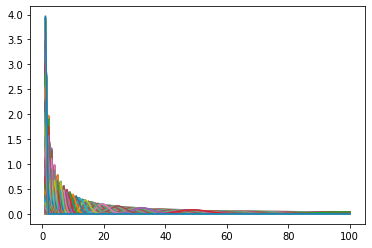

In [71]:
import seaborn as sns
from pyro.distributions import Gamma
shape = 1
data = np.linspace(1, 100, num=100)
data
# g = Gamma(shape, 1)
# torch.exp(g.log_prob([data]))
# # sns.distplot(data, torch.exp(g.log_prob([data])))
# plt.plot(data, torch.exp(g.log_prob([data]))[0])
# for rate in range(1, 100):
#     d = Gamma(shape, rate)
#     # p = d.sample(1000)
#     plt.plot(data, torch.exp(d.log_prob([data]))[0])

for shape in range(1, 100):
    for rate in range(1, 100):
        # print(shape, rate)
        d = Gamma(shape, rate)
        # p = d.sample(1000)
        plt.plot(data, torch.exp(d.log_prob([data]))[0])



In [ ]:
## Eight school example